# Gem Classifier Project by Sapir Dahan

This Python notebook contains the code for classifying 75 different types of gem images. We provide the code with only few examples of each gem. A neural network model usually needs tens of thousands of images per class in order to learn the features of each class.
Since our dataset is very limited we need to use a method called transfer learning.

In transfer learning we use a pre-trained model, and just replace the last few layers of the model with new ones. The new model learns in two stages.

1. Feature Extraction: Freeze the existing pre-trained layers and use them for feature extraction, and train the new last few layers to classify the gems.
1. Fine-Tuning: Unfreeze a few of the last layers of the pre-trained model and jointly train them with the newly-added layers.

There are many machine learning frameworks. In this project we use one of the most popular ones: Tensorflow by Google.

The selected neural network model for this project is ResNet50. It's a complex convolutional neural network (CNN) that provides very good accuracy, with relatively fast training time.

This code will follow machine learning workflow.

1. Examine and understand the data
1. Build an input pipeline
1. Compose the model
   * Load in the pretrained base model (and pretrained weights)
   * Stack the classification layers on top
1. Train the model in two stages as described above
1. Evaluate model

### Hyperparameters

In [1]:
BATCH_SIZE = 32 # Mini-batch size
IMG_SIZE = (224, 224) # Input image size
test_split = 0.1 # Proportion of the test set out of the full dataset
validation_split = 0.1 # Proportion of the validation set out of the full dataset
print("Dataset Split: Train %2.0f%%, Validation %2.0f%%, Test %2.0f%%." %
     (100*(1-test_split-validation_split), 100*validation_split, 100*test_split))
initial_epochs = 300 # Initial number of epochs
fine_tune_epochs = 2000 # Fine tune number of epochs
base_learning_rate = 0.0001 # Base learning rate
dropout = 0.82 # Dropout rate
fine_tune_at = 50 # Fine-tune from this layer onwards

Dataset Split: Train 80%, Validation 10%, Test 10%.


### Import Packages

In [2]:
%load_ext tensorboard

import matplotlib.pyplot as plt
import numpy as np
import os
import tensorflow as tf
import datetime
import sklearn.metrics
import itertools
import pickle
from tensorflow.keras.preprocessing import image_dataset_from_directory

## Data preprocessing

### Data download

In this section we will download the gem images dataset, and split it to 3 distinct datasets:
1. Train Dataset
2. Validation Dataset
3. Test Dataset

In [3]:
PATH = os.path.join('C:/Users/User/Dropbox/DeepLearning/Data/gems')

dataset_dir = os.path.join(PATH)

full_dataset = image_dataset_from_directory(dataset_dir,
                                             shuffle=True,
                                             batch_size=BATCH_SIZE,
                                             image_size=IMG_SIZE)

Found 2796 files belonging to 75 classes.


### Split the data to Train, Validation and Test

In [4]:
num_of_batches = float(tf.data.experimental.cardinality(full_dataset))
test_dataset = full_dataset.take(int(num_of_batches * test_split))
train_dataset = full_dataset.skip(int(num_of_batches * test_split))
validation_dataset = train_dataset.take(int(num_of_batches * validation_split))
train_dataset = train_dataset.skip(int(num_of_batches * validation_split))

print('Number of train batches: %d' % tf.data.experimental.cardinality(train_dataset))
print('Number of validation batches: %d' % tf.data.experimental.cardinality(validation_dataset))
print('Number of test batches: %d' % tf.data.experimental.cardinality(test_dataset))

Number of train batches: 72
Number of validation batches: 8
Number of test batches: 8


Show the first nine images and labels from the training set:

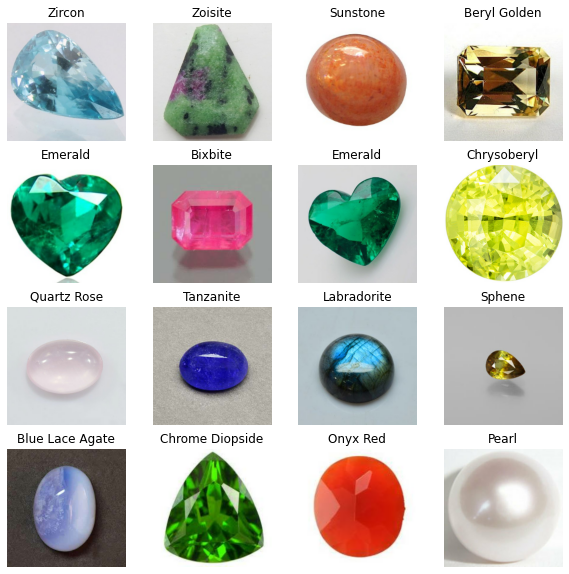

In [5]:
class_names = full_dataset.class_names
class_count = len(full_dataset.class_names)

plt.figure(figsize=(10, 10))
for images, labels in train_dataset.take(1):
  for i in range(16):
    ax = plt.subplot(4, 4, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[labels[i]])
    plt.axis("off")

### Configure the dataset for performance

Use buffered prefetching to load images from disk to speedup the processing time.

In [6]:
AUTOTUNE = tf.data.AUTOTUNE

train_dataset = train_dataset.prefetch(buffer_size=AUTOTUNE)
validation_dataset = validation_dataset.prefetch(buffer_size=AUTOTUNE)
test_dataset = test_dataset.prefetch(buffer_size=AUTOTUNE)

### Use data augmentation

Since we don't have a large image dataset, it's a good practice to artificially introduce sample diversity by applying random, yet realistic, transformations to the training images. This helps expose the model to different aspects of the training data and reduce overfitting.

In [7]:
data_augmentation = tf.keras.Sequential([
    tf.keras.layers.experimental.preprocessing.RandomFlip('horizontal'),
    tf.keras.layers.experimental.preprocessing.RandomFlip('vertical'),
    tf.keras.layers.experimental.preprocessing.RandomRotation(0.9)
    #tf.keras.layers.experimental.preprocessing.RandomContrast(0.5)
])

These layers are active only during training, when we call model.fit. They are inactive when the model is used in inference mode in model.evaulate.
Now we'll repeatedly apply these layers to the same image and see the result.

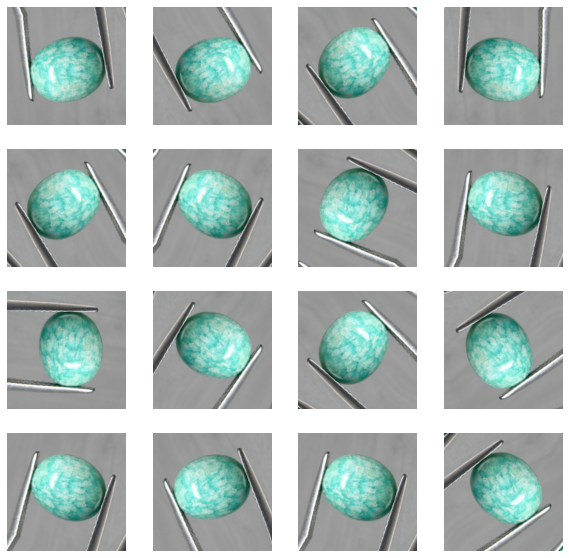

In [8]:
for image, _ in train_dataset.take(1):
  plt.figure(figsize=(10, 10))
  first_image = image[0]
  for i in range(16):
    ax = plt.subplot(4, 4, i + 1)
    augmented_image = data_augmentation(tf.expand_dims(first_image, 0))
    plt.imshow(augmented_image[0] / 255)
    plt.axis('off')

### Rescale pixel values

The ResNet50 model expects pixel values in [-1, 1], but at this point, the pixel values in our images are in [0, 255]. To rescale them, we use the preprocessing method included with the model.

In [9]:
preprocess_input = tf.keras.applications.resnet50.preprocess_input

## Create the base model from the pre-trained CNN

In [10]:
# Create the base model from the pre-trained ResNet50 model
IMG_SHAPE = IMG_SIZE + (3,)
base_model = tf.keras.applications.resnet50.ResNet50(input_shape=IMG_SHAPE,
                                               include_top=False,
                                               weights='imagenet')

This feature extractor converts each 224x224x3 image into a 7x7x2048 block of features. Let's see what it does to an example batch of images:

In [11]:
image_batch, label_batch = next(iter(train_dataset))
feature_batch = base_model(image_batch)
print(feature_batch.shape)

(32, 7, 7, 2048)


## Feature extraction
In this step, we will freeze the convolutional base created from the previous step and to use as a feature extractor. Additionally, we add a classifier on top of it and train the top-level classifier.

### Freeze the convolutional base

It is important to freeze the convolutional base before we compile and train the model. Freezing (by setting layer.trainable = False) prevents the weights in a given layer from being updated during training. resnet50 has many layers, so setting the entire model's `trainable` flag to False will freeze all of them.

In [12]:
base_model.trainable = False

In [13]:
# Now we'll print base model architecture
base_model.summary()

Model: "resnet50"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 230, 230, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
conv1_conv (Conv2D)             (None, 112, 112, 64) 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
conv1_bn (BatchNormalization)   (None, 112, 112, 64) 256         conv1_conv[0][0]                 
___________________________________________________________________________________________

### Add a classification head


Build a model by chaining together the data augmentation, rescaling, base_model and feature extractor layers.

In [14]:
inputs = tf.keras.Input(shape=IMG_SHAPE)
x = data_augmentation(inputs)
x = preprocess_input(x)
x = base_model(x, training=False)
x = tf.keras.layers.GlobalAveragePooling2D()(x)
x = tf.keras.layers.Dropout(dropout)(x)
outputs = tf.keras.layers.Dense(class_count, activation='softmax')(x)
model = tf.keras.Model(inputs, outputs)

### Compile the model

In [15]:
model.compile(optimizer=tf.keras.optimizers.Adam(lr=base_learning_rate),
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

c:\users\user\pycharmprojects\sapir\venv\lib\site-packages\tensorflow\python\keras\optimizer_v2\optimizer_v2.py:374: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  warnings.warn(


In [16]:
model.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
sequential (Sequential)      (None, 224, 224, 3)       0         
_________________________________________________________________
tf.__operators__.getitem (Sl (None, 224, 224, 3)       0         
_________________________________________________________________
tf.nn.bias_add (TFOpLambda)  (None, 224, 224, 3)       0         
_________________________________________________________________
resnet50 (Functional)        (None, 7, 7, 2048)        23587712  
_________________________________________________________________
global_average_pooling2d (Gl (None, 2048)              0         
_________________________________________________________________
dropout (Dropout)            (None, 2048)              0     

The 2.35M parameters in resnet50 are frozen, but there are 153K _trainable_ parameters in the Dense layer.

### Evaluate the model before transfer learning

In [17]:
loss0, accuracy0 = model.evaluate(validation_dataset)
print("initial loss: {:.3f}".format(loss0))
print("initial accuracy: {:.3f}".format(accuracy0))

c:\users\user\pycharmprojects\sapir\venv\lib\site-packages\tensorflow\python\keras\backend.py:4929: UserWarning: "`sparse_categorical_crossentropy` received `from_logits=True`, but the `output` argument was produced by a sigmoid or softmax activation and thus does not represent logits. Was this intended?"
  warnings.warn(


8/8 [==============================] - 2s 47ms/step - loss: 5.1518 - accuracy: 0.0078
initial loss: 5.152
initial accuracy: 0.008


### Train the model

In [18]:
history = model.fit(train_dataset,
                    epochs=initial_epochs,
                    validation_data=validation_dataset,
                    callbacks=[tensorboard_callback])

Epoch 1/300


c:\users\user\pycharmprojects\sapir\venv\lib\site-packages\tensorflow\python\keras\utils\generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


72/72 [==============================] - 7s 68ms/step - loss: 7.5397 - accuracy: 0.0140 - val_loss: 4.5161 - val_accuracy: 0.0117

### Learning curves

Display the learning curves of the training and validation accuracy/loss when using the resnet50 base model as a fixed feature extractor.

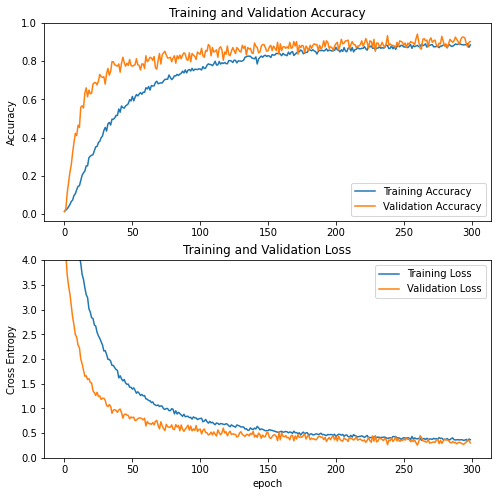

In [19]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0,4.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

## Fine tuning
In the feature extraction experiment, we were only training the last layer on top of an resnet50 base model. The weights of the pre-trained network were **not** updated during training.

One way to increase performance even further is to train (or "fine-tune") the weights of the top layers of the pre-trained model alongside the training of the classifier we added. The training process will force the weights to be tuned from generic feature maps to features associated specifically with our gem dataset.

This should only be attempted after we have trained the top-level classifier with the pre-trained model set to non-trainable. If we add a randomly initialized classifier on top of a pre-trained model and attempt to train all layers jointly, the magnitude of the gradient updates will be too large (due to the random weights from the classifier) and our pre-trained model will forget what it has learned.

Also, we should try to fine-tune a small number of top layers rather than the whole resnet50 model. In most convolutional networks, the higher up a layer is, the more specialized it is. The first few layers learn very simple and generic features that generalize to almost all types of images. As we go higher up, the features are increasingly more specific to the dataset on which the model was trained. The goal of fine-tuning is to adapt these specialized features to work with the gem dataset, rather than overwrite the generic learning.

### Un-freeze the top layers of the model

All we need to do is unfreeze the base_model and set the bottom layers to be un-trainable. Then, we recompile the model (necessary for these changes to take effect), and resume training.

In [20]:
base_model.trainable = True

In [21]:
# See how many layers are in the base model
print("Number of layers in the base model: ", len(base_model.layers))

# Freeze all the layers before the `fine_tune_at` layer
for layer in base_model.layers[:fine_tune_at]:
  layer.trainable =  False

Number of layers in the base model:  175


### Compile the model

As we are training a much larger model and want to readapt the pretrained weights, it is important to use a lower learning rate at this stage. Otherwise, our model could overfit very quickly.

In [22]:
model.compile(loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              optimizer = tf.keras.optimizers.Adam(lr=base_learning_rate/10),
              metrics=['accuracy'])

In [23]:
model.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
sequential (Sequential)      (None, 224, 224, 3)       0         
_________________________________________________________________
tf.__operators__.getitem (Sl (None, 224, 224, 3)       0         
_________________________________________________________________
tf.nn.bias_add (TFOpLambda)  (None, 224, 224, 3)       0         
_________________________________________________________________
resnet50 (Functional)        (None, 7, 7, 2048)        23587712  
_________________________________________________________________
global_average_pooling2d (Gl (None, 2048)              0         
_________________________________________________________________
dropout (Dropout)            (None, 2048)              0     

### Continue training the model

In [24]:
total_epochs =  initial_epochs + fine_tune_epochs

history_fine = model.fit(train_dataset,
                         epochs=total_epochs,
                         initial_epoch=history.epoch[-1],
                         validation_data=validation_dataset,
                         callbacks=[tensorboard_callback])

Epoch 300/2300
72/72 [==============================] - 18s 151ms/step - loss: 0.3379 - accuracy: 0.8954 - val_loss: 0.2048 - val_accuracy: 0.9375

Display the learning curves of the training and validation accuracy/loss when fine-tuning the last few layers of the resnet50 base model and training the classifier on top of it.

In [25]:
acc += history_fine.history['accuracy']
val_acc += history_fine.history['val_accuracy']

loss += history_fine.history['loss']
val_loss += history_fine.history['val_loss']

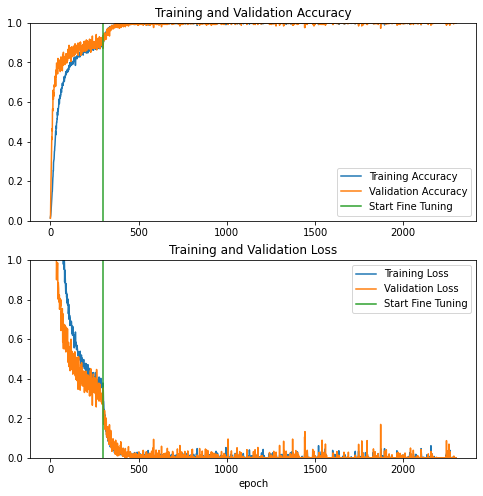

In [26]:
plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.ylim([0, 1])
plt.plot([initial_epochs-1,initial_epochs-1],
          plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.ylim([0, 1.0])
plt.plot([initial_epochs-1,initial_epochs-1],
         plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

## Confusion Matrix - Validation Data

c:\users\user\pycharmprojects\sapir\venv\lib\site-packages\sklearn\utils\validation.py:70: FutureWarning: Pass labels=range(0, 75) as keyword args. From version 1.0 (renaming of 0.25) passing these as positional arguments will result in an error
  warnings.warn(f"Pass {args_msg} as keyword args. From version "


Text(0.5, 316.6749999999999, 'Predicted label')

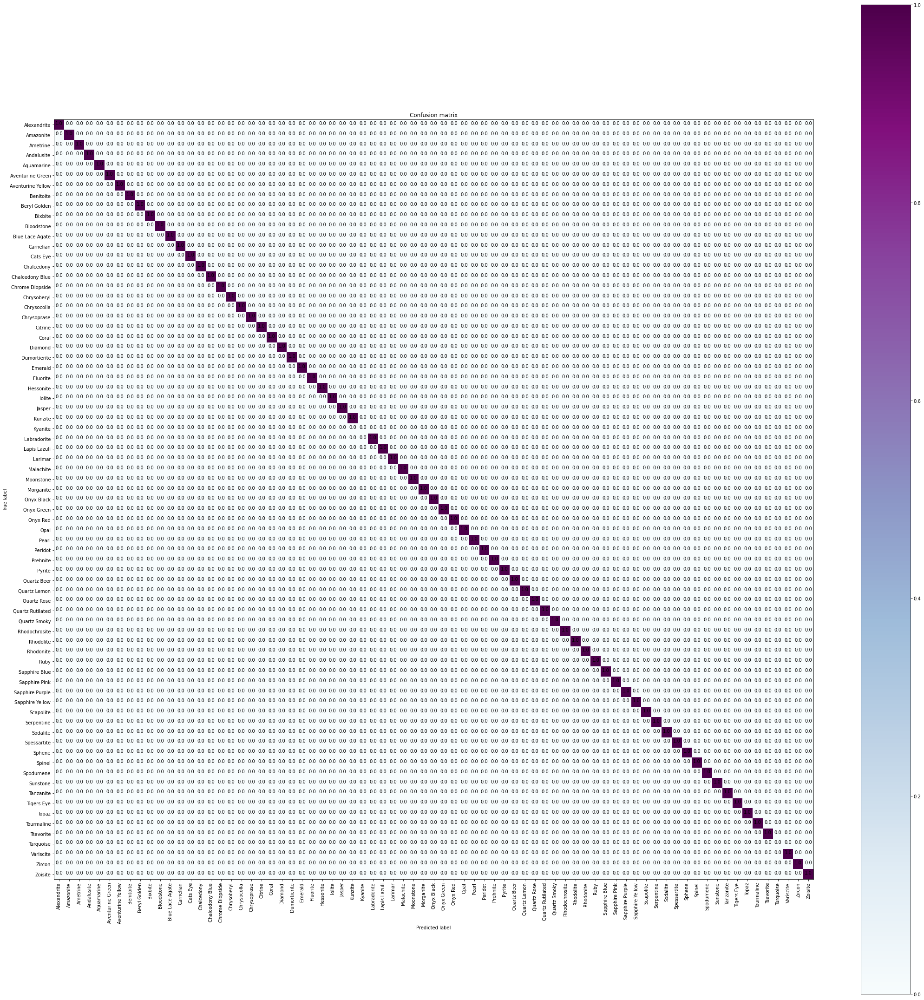

In [27]:
validation_labels_concat =  tf.zeros([0], tf.int32)
validation_pred_concat =  tf.zeros([0], tf.int64)
for validation_images, validation_labels in validation_dataset:
    validation_pred_raw = model.predict(validation_images)
    validation_pred = tf.argmax(validation_pred_raw, axis=1)
    validation_labels_concat = tf.concat([validation_labels_concat, validation_labels], axis=-1)
    validation_pred_concat = tf.concat([validation_pred_concat, validation_pred], axis=-1)

cm = sklearn.metrics.confusion_matrix(validation_labels_concat, validation_pred_concat, range(75))
a= cm.astype('float')
b = cm.sum(axis=1)[:, np.newaxis]
c = np.divide(a, b, out=np.zeros_like(a), where=b!=0)
cm = np.around(c, decimals=2)

figure = plt.figure(figsize=(30, 30))
plt.imshow(cm, interpolation='nearest', cmap=plt.cm.BuPu)
plt.title("Confusion matrix")
plt.colorbar()
tick_marks = np.arange(len(class_names))
plt.xticks(tick_marks, class_names, rotation=90)
plt.yticks(tick_marks, class_names)
for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
    plt.text(j, i, cm[i, j], horizontalalignment="center", color="black")
plt.tight_layout()
plt.ylabel('True label')
plt.xlabel('Predicted label')

### Model evaluation and test set prediction

Finally, we can verify the performance of the model on the gem data using test set.

In [28]:
loss, accuracy = model.evaluate(test_dataset)
print('Test accuracy :', accuracy)

8/8 [==============================] - 1s 58ms/step - loss: 2.7727e-06 - accuracy: 1.0000
Test accuracy : 1.0


And now we are all set to use this model to classify the test gem images.

Predictions:
 [63 55 58 14 68 31 54 52 16 71 25 63 62  1 51 41 19 24  4 44  2 26  5 59
 33 11 58 33 41 58 19 54]
Labels:
 [63 55 58 14 68 31 54 52 16 71 25 63 62  1 51 41 19 24  4 44  2 26  5 59
 33 11 58 33 41 58 19 54]


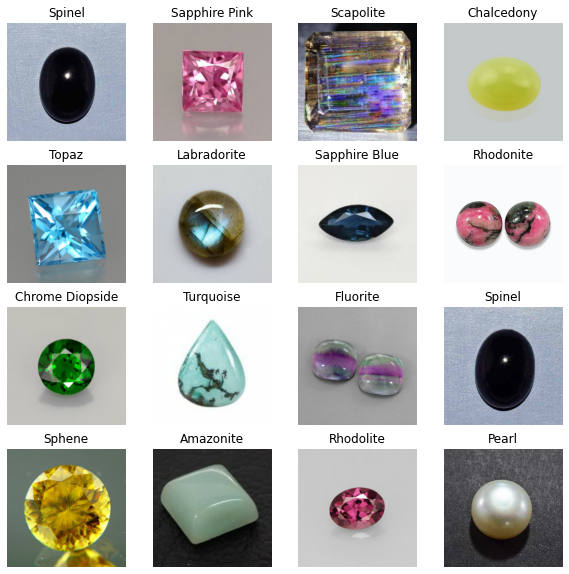

In [29]:
#Retrieve a batch of images from the test set
image_batch, label_batch = test_dataset.as_numpy_iterator().next()
predictions = model.predict_on_batch(image_batch)
predictions = tf.argmax(input=predictions, axis=1)

print('Predictions:\n', predictions.numpy())
print('Labels:\n', label_batch)

plt.figure(figsize=(10, 10))
for i in range(16):
  ax = plt.subplot(4, 4, i + 1)
  plt.imshow(image_batch[i].astype("uint8"))
  plt.title(class_names[predictions[i]])
  plt.axis("off")

## Confusion Matrix - Test Data

c:\users\user\pycharmprojects\sapir\venv\lib\site-packages\sklearn\utils\validation.py:70: FutureWarning: Pass labels=range(0, 75) as keyword args. From version 1.0 (renaming of 0.25) passing these as positional arguments will result in an error
  warnings.warn(f"Pass {args_msg} as keyword args. From version "


Text(0.5, 316.6749999999999, 'Predicted label')

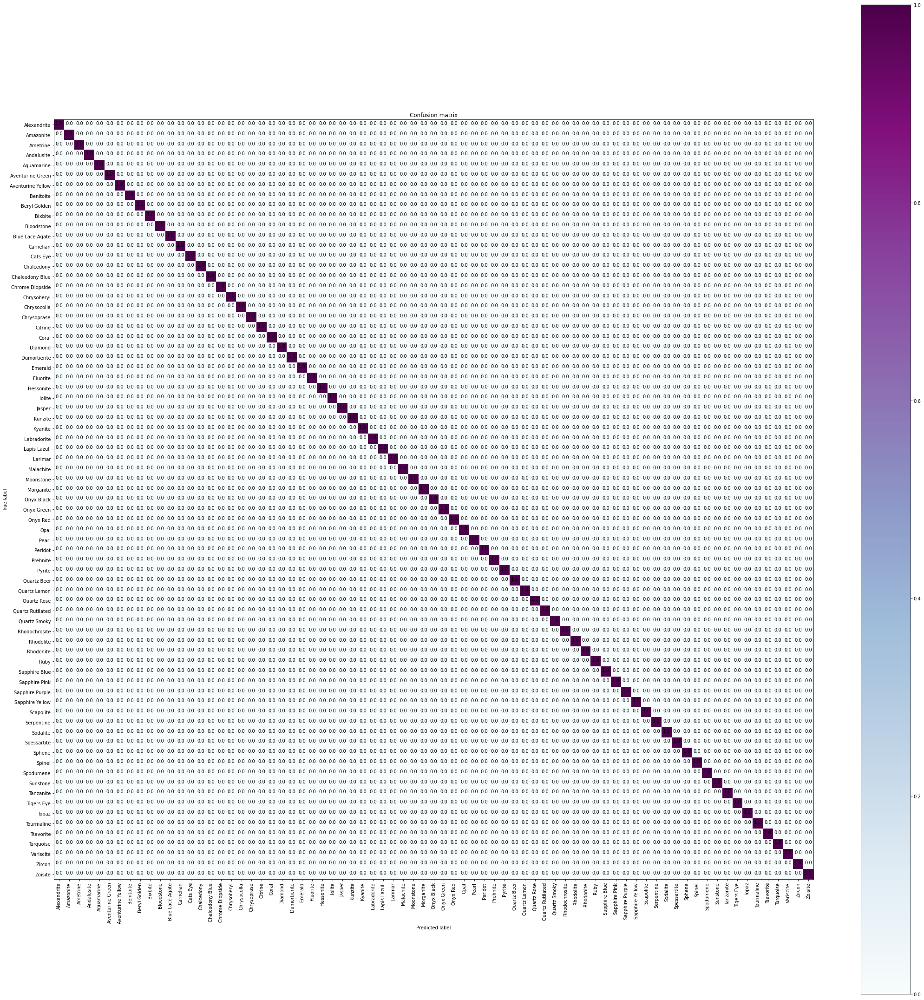

In [30]:
test_labels_concat =  tf.zeros([0], tf.int32)
test_pred_concat =  tf.zeros([0], tf.int64)
for test_images, test_labels in test_dataset:
    test_pred_raw = model.predict(test_images)
    test_pred = tf.argmax(test_pred_raw, axis=1)
    test_labels_concat = tf.concat([test_labels_concat, test_labels], axis=-1)
    test_pred_concat = tf.concat([test_pred_concat, test_pred], axis=-1)

cm = sklearn.metrics.confusion_matrix(test_labels_concat, test_pred_concat, range(75))
a= cm.astype('float')
b = cm.sum(axis=1)[:, np.newaxis]
c = np.divide(a, b, out=np.zeros_like(a), where=b!=0)
cm = np.around(c, decimals=2)

figure = plt.figure(figsize=(30, 30))
plt.imshow(cm, interpolation='nearest', cmap=plt.cm.BuPu)
plt.title("Confusion matrix")
plt.colorbar()
tick_marks = np.arange(len(class_names))
plt.xticks(tick_marks, class_names, rotation=90)
plt.yticks(tick_marks, class_names)
for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
    plt.text(j, i, cm[i, j], horizontalalignment="center", color="black")
plt.tight_layout()
plt.ylabel('True label')
plt.xlabel('Predicted label')

## Save Model

In [31]:
with open('C:/Users/User/Dropbox/DeepLearning/Models/class_names.txt', 'wb') as fp:
     pickle.dump(class_names, fp)

model.save('C:/Users/User/Dropbox/DeepLearning/Models/')


c:\users\user\pycharmprojects\sapir\venv\lib\site-packages\tensorflow\python\keras\utils\generic_utils.py:494: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  warnings.warn('Custom mask layers require a config and must override '


INFO:tensorflow:Assets written to: C:/Users/User/Dropbox/DeepLearning/Models/assets
